In [392]:
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt

sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=100, facecolor='white', frameon=True, fontsize=20, figsize=(12, 12))

perinectoric_gene_list = ["CD44"]
# necrosis_gene_list = ["PGK1", "NDRG1", "HK2", "TNFAIP3", "ANGPTL4", "LIF", "IDS"]
necrosis_gene_list = ["PGK1", "NDRG1", "HK2", "ANGPTL4", "IDS"]
# necrosis_gene_list = ["PGK1", "NDRG1", "HK2"]
infiltrating_gene_list = ["SLC20A2", "GABBR2", "HS6ST1", "RARRES1", "ATP1B1"]
perivascular_zone = ["NALF1", "PDE4D", "MAST4"]
ct_gene_list = ["IGFBP2", "TIMP1", "EZH2"]
leading_edge = ["BIRC5", "CCNB2", "CCNB1"]
microvascular1 = ["NOSTRIN", "MKI67"]
microvascular2 = ["MAST4", "PECAM1",  "PXDN"]

genes_list = necrosis_gene_list  + ct_gene_list + leading_edge + microvascular2
# genes_list = necrosis_gene_list + ct_gene_list + infiltrating_gene_list + microvascular2 + leading_edge
# ensure gnees are unique
# genes_list = list(set(genes_list))



scanpy==1.9.3 anndata==0.9.1 umap==0.5.3 numpy==1.24.4 scipy==1.11.0 pandas==1.5.3 scikit-learn==1.2.2 statsmodels==0.14.0 python-igraph==0.10.6 louvain==0.8.1 pynndescent==0.5.10


In [357]:
adata = sc.read('write/human_combined_3.h5ad')
# sc.pp.log1p(adata)
# redo neighbors and umap
# sc.pp.neighbors(adata, n_pcs=25, n_neighbors=40)
# sc.tl.umap(adata, min_dist=0.4, spread=0.3)
# sc.pl.umap(adata, color="louvain", size=50, alpha=0.7, legend_loc="on data", title="Louvain Clustering (Res=1)")


/Users/shaunie/anaconda3/envs/hu-aging/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


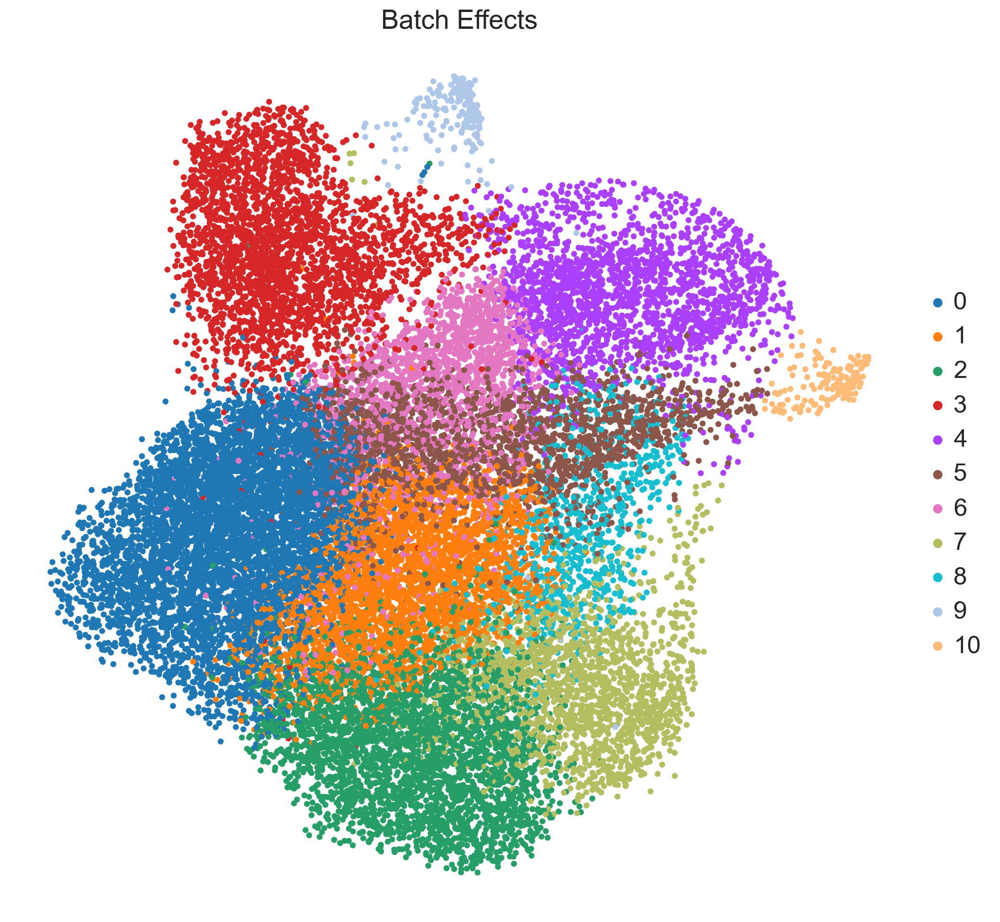

In [321]:
sc.pl.umap(adata, color=['louvain'], frameon=False, size=80, title="Batch Effects")


In [322]:
# sc.pl.umap(adata, color=['louvain'], frameon=False, size=80, title="clusters")
# 0 is Infiltarating
# 1 is Mixed
# 2 is Necrotic
# 3 is Leading Edge
# 4 is Central Core
# 5 is Mixed
# 6 is Central Core
# 7 is Necrotic
# 8 is Nectoric
# 9 is Vascular
# 10 is Mixed



In [323]:
# sc.pl.tsne(adata, color=['batch'], size=80, title="Batch Effects")

In [358]:
necrosis_data = adata[:, necrosis_gene_list].X
necrosis_expression = np.sum(necrosis_data, axis=1)
necrosis_expression = pd.DataFrame(necrosis_expression)

perinectoric_data = adata[:, perinectoric_gene_list].X
perinectoric_expression = np.sum(perinectoric_data, axis=1)
perinectoric_expression = pd.DataFrame(perinectoric_expression)

infiltrating_data = adata[:, infiltrating_gene_list].X
infiltrating_expression = np.sum(infiltrating_data, axis=1)
infiltrating_expression = pd.DataFrame(infiltrating_expression)

perivascular_data = adata[:, perivascular_zone].X
perivascular_expression = np.sum(perivascular_data, axis=1)
perivascular_expression = pd.DataFrame(perivascular_expression)

ct_data = adata[:, ct_gene_list].X
ct_expression = np.sum(ct_data, axis=1)
ct_expression = pd.DataFrame(ct_expression)

leading_edge_data = adata[:, leading_edge].X
leading_edge_expression = np.sum(leading_edge_data, axis=1)
leading_edge_expression = pd.DataFrame(leading_edge_expression)

microvascular_data1 = adata[:, microvascular1].X
microvascular_expression1 = np.sum(microvascular_data1, axis=1)
microvascular_expression1 = pd.DataFrame(microvascular_expression1)
adata.obs["m1"] = pd.Series(microvascular_expression1[0].values, index=adata.obs.index)


microvascular_data2 = adata[:, microvascular2].X
microvascular_expression2 = np.sum(microvascular_data2, axis=1)
microvascular_expression2 = pd.DataFrame(microvascular_expression2)
adata.obs["m2"] = pd.Series(microvascular_expression2[0].values, index=adata.obs.index)

# for i in genes_list:
#     adata.obs[i] = pd.Series(adata[:, i].X.toarray()[:, 0], index=adata.obs.index)



In [360]:
# add to adata
adata.obs["necrosis"] = pd.Series(necrosis_expression[0].values, index=adata.obs.index)
adata.obs["perinectoric"] = pd.Series(perinectoric_expression[0].values, index=adata.obs.index)
adata.obs["infiltrating"] = pd.Series(infiltrating_expression[0].values, index=adata.obs.index)
adata.obs["perivascular"] = pd.Series(perivascular_expression[0].values, index=adata.obs.index)
adata.obs["ct"] = pd.Series(ct_expression[0].values, index=adata.obs.index)
adata.obs["leading_edge"] = pd.Series(leading_edge_expression[0].values, index=adata.obs.index)
adata.obs["m2"] = pd.Series(microvascular_expression2[0].values, index=adata.obs.index)

adata.obs

,batch,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden,louvain,m1,m2,necrosis,perinectoric,infiltrating,perivascular,ct,leading_edge
AAACCCACAAAGGAGA-1-1914_human,1914_human,2338,2338,4497.0,44.0,0.978430,4,1,0.010754,-0.010889,1.896652,-0.076185,-0.273447,-0.010338,2.905940,-0.008556
AAACCCAGTTGTCCCT-1-1914_human,1914_human,4193,4192,9235.0,2.0,0.021657,0,0,0.010754,-0.010889,1.530224,-0.076185,3.421579,-0.010338,2.768715,-0.008556
AAACGAAAGCTCATAC-1-1914_human,1914_human,3384,3384,7311.0,5.0,0.068390,1,0,0.010754,-0.010889,0.449921,-0.076185,1.814115,-0.010338,1.216965,-0.008556
AAACGAAGTGTCCAAT-1-1914_human,1914_human,878,878,1131.0,1.0,0.088417,4,1,0.010754,-0.010889,1.973932,-0.076185,-0.273447,-0.010338,0.361201,-0.008556
AAACGCTAGTAGTGCG-1-1914_human,1914_human,1793,1793,3368.0,3.0,0.089074,7,7,0.010754,-0.010889,6.958173,-0.076185,-0.273447,-0.010338,2.284322,-0.008556
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGCATCCTTGC-1-1919d_human,1919d_human,1593,1593,2256.0,6.0,0.265957,3,3,1.415441,-0.003665,0.515680,0.044461,3.148563,-0.015034,2.147244,-0.023271
TTTGTTGGTGTAGTGG-1-1919d_human,1919d_human,2484,2484,4690.0,5.0,0.106610,9,5,-0.028584,-0.003665,3.486072,1.198950,-0.053717,-0.015034,4.469689,1.030891
TTTGTTGTCCATACTT-1-1919d_human,1919d_human,1155,1155,1594.0,115.0,7.214554,5,6,-0.028584,-0.003665,0.515680,0.044461,1.845246,-0.015034,3.487260,-0.023271
TTTGTTGTCCCAAGCG-1-1919d_human,1919d_human,1261,1261,1564.0,6.0,0.383632,6,1,-0.028584,-0.003665,0.515680,2.067460,1.811158,-0.015034,0.004572,-0.023271


In [324]:
# flip Umap1
adata.obsm['X_umap'][:,0] = -1*adata.obsm['X_umap'][:,0]
# flip Umap2
adata.obsm['X_umap'][:,1] = -1*adata.obsm['X_umap'][:,1]

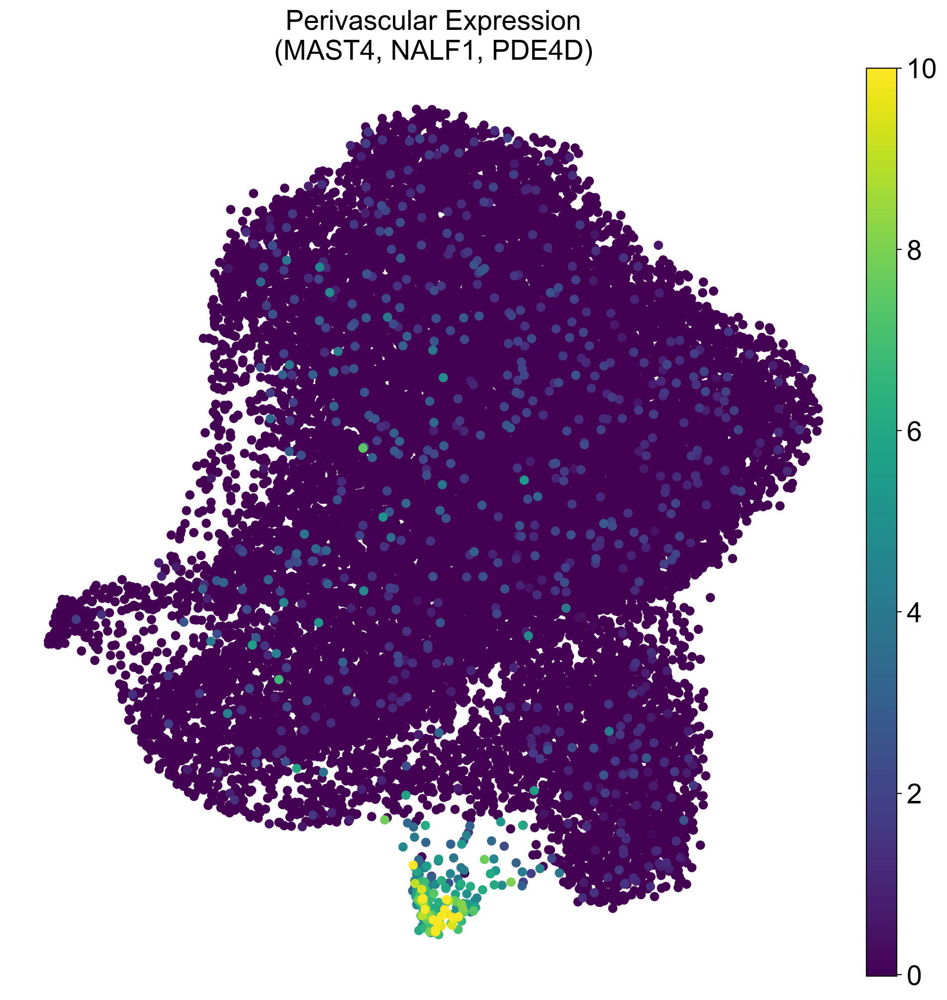

<Figure size 1200x1200 with 0 Axes>

In [9]:
sc.pl.umap(adata, color=['perivascular'], frameon=False, size=180, vmax=10, title="Perivascular Expression\n(MAST4, NALF1, PDE4D)")
plt.savefig('figures/perivascular_expression.png', dpi=300, bbox_inches='tight')

In [10]:
# sc.pl.tsne(adata, color=['perivascular'], frameon=False, size=80, vmax=10, title="Perivascular Expression\n(MAST4, NALF1, PDE4D)")

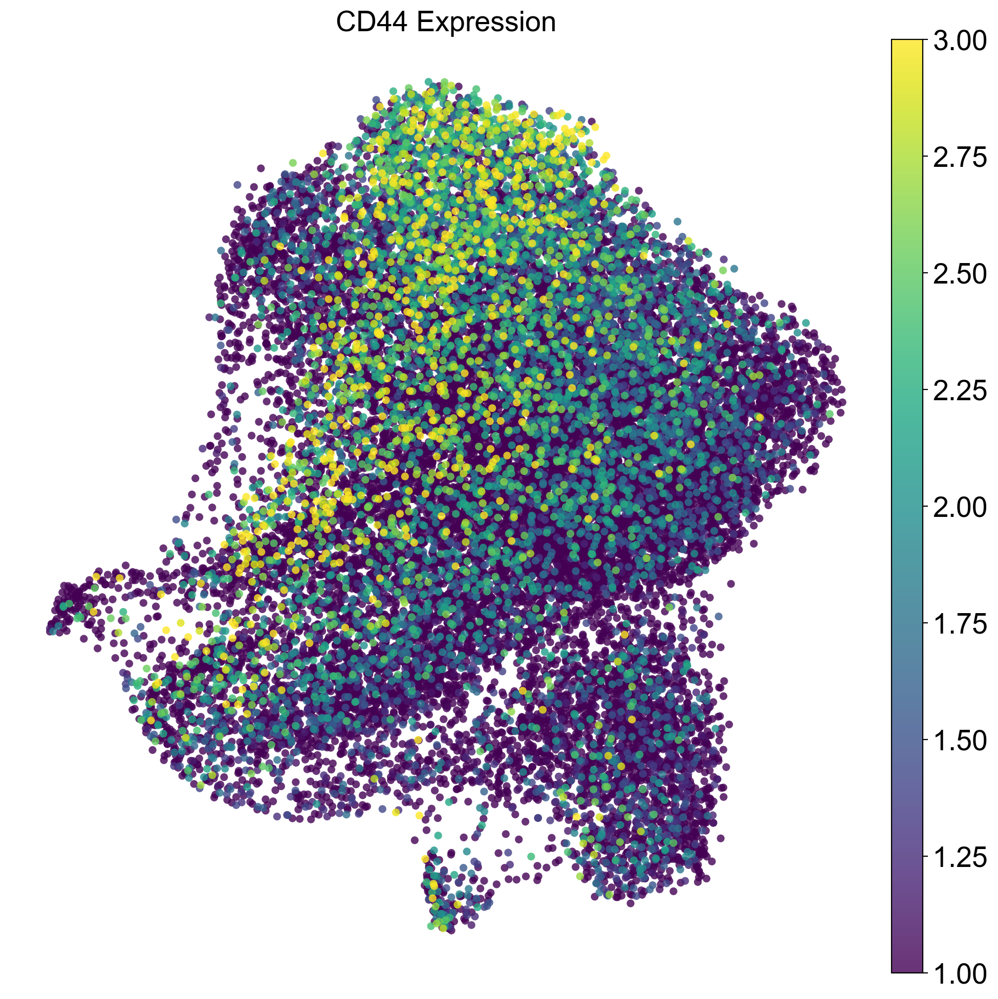

<Figure size 1200x1200 with 0 Axes>

In [42]:
sc.pl.umap(adata, color=["CD44"], frameon=False, size=120, alpha=0.8, vmax=3, vmin=1, title="CD44 Expression")
# save figure to file
plt.savefig('figures/CD44_expression.png', dpi=300, bbox_inches='tight')

In [12]:
# sc.pl.tsne(adata, color=["CD44"], frameon=False, size=150, vmax=6, vmin=2, title="CD44 Expression")


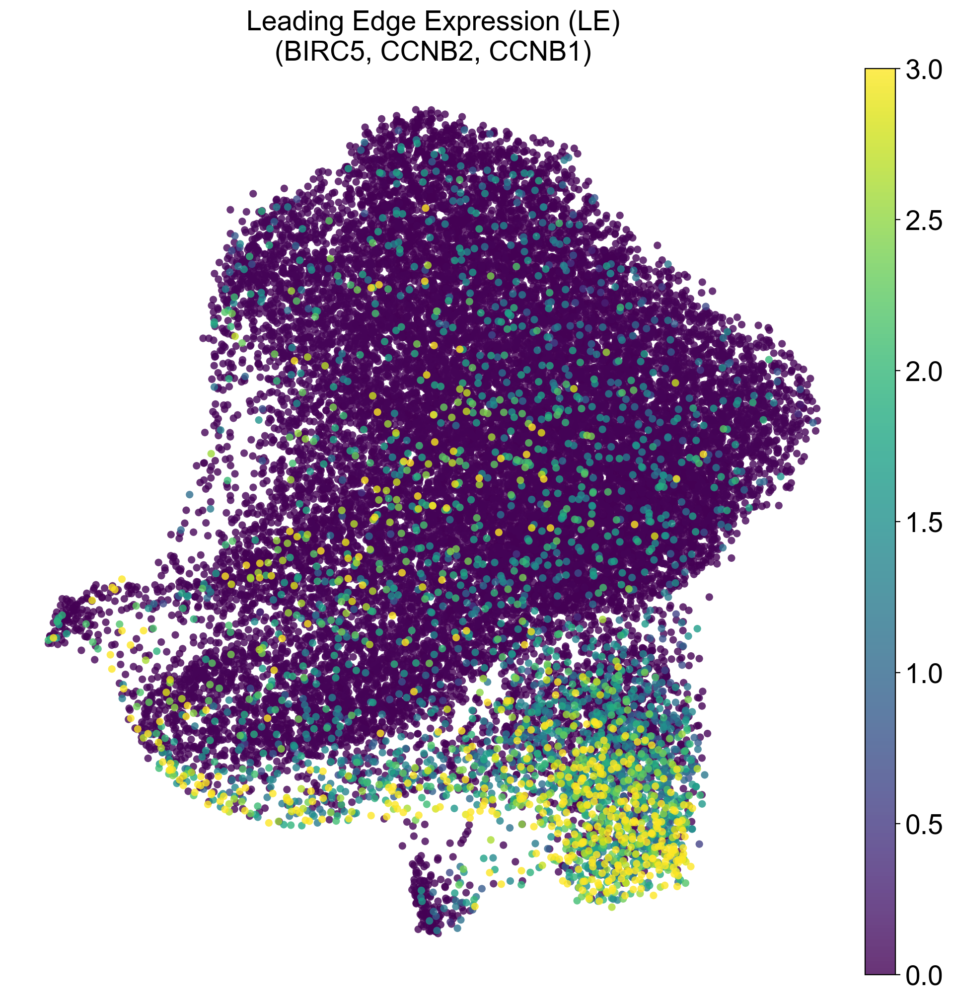

<Figure size 1200x1200 with 0 Axes>

In [39]:

# include subtitle to write BIRC5, CCNB2, CCNB1
sc.pl.umap(adata, color=['leading_edge'], frameon=False, size=120, alpha=0.8, vmin=0, vmax=3, title="Leading Edge Expression (LE)\n(BIRC5, CCNB2, CCNB1)")
plt.savefig('figures/leading_edge_expression.png', dpi=300, bbox_inches='tight')

In [14]:
# sc.pl.tsne(adata, color=['leading_edge'], frameon=False, size=150, vmin=0, vmax=10, title="Leading Edge Expression (LE)\n(BIRC5, CCNB2, CCNB1)")


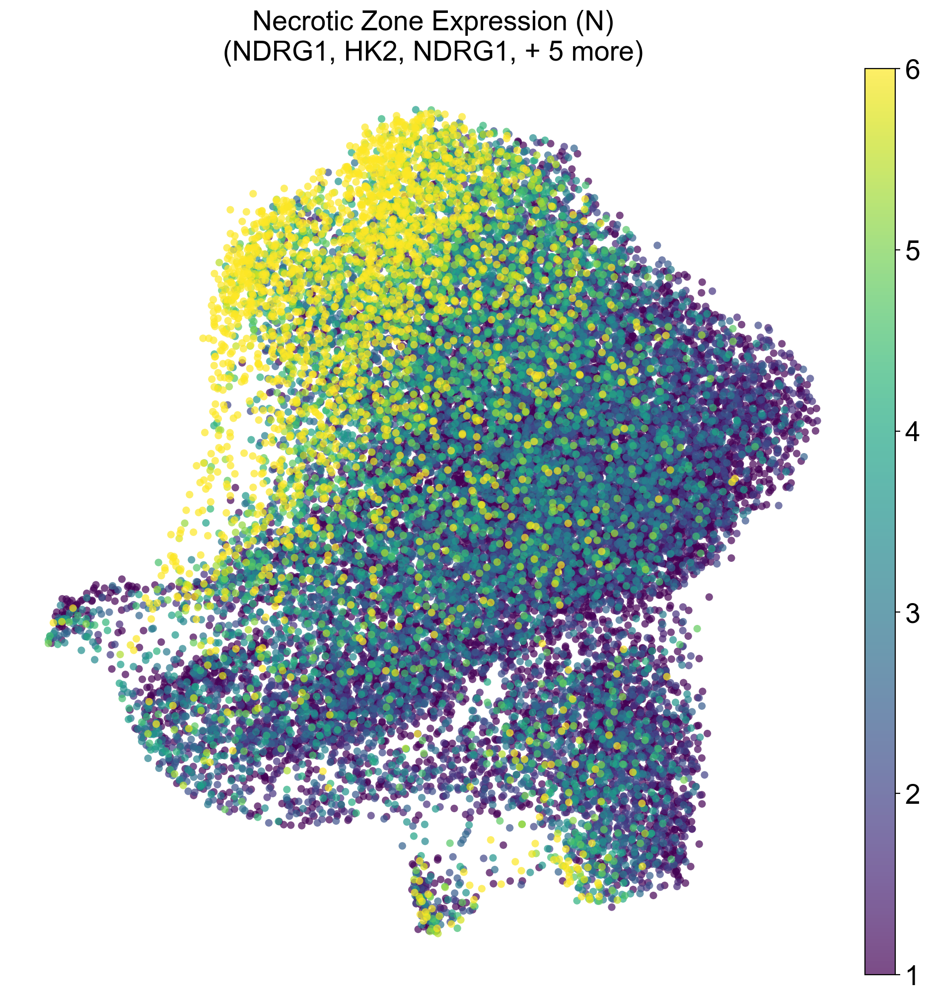

<Figure size 1200x1200 with 0 Axes>

In [22]:
sc.pl.umap(adata, color='necrosis', frameon=False , size=120, vmin=1, vmax=6, alpha=0.7, title="Necrotic Zone Expression (N)\n(NDRG1, HK2, NDRG1, + 5 more)")
plt.savefig('figures/necrosis_expression.png', dpi=300, bbox_inches='tight')

In [16]:
# sc.pl.tsne(adata, color='necrosis', frameon=False , size=150, vmin=1, title="Necrotic Zone Expression (N)\n(NDRG1, HK2, NDRG1, + 5 more)")

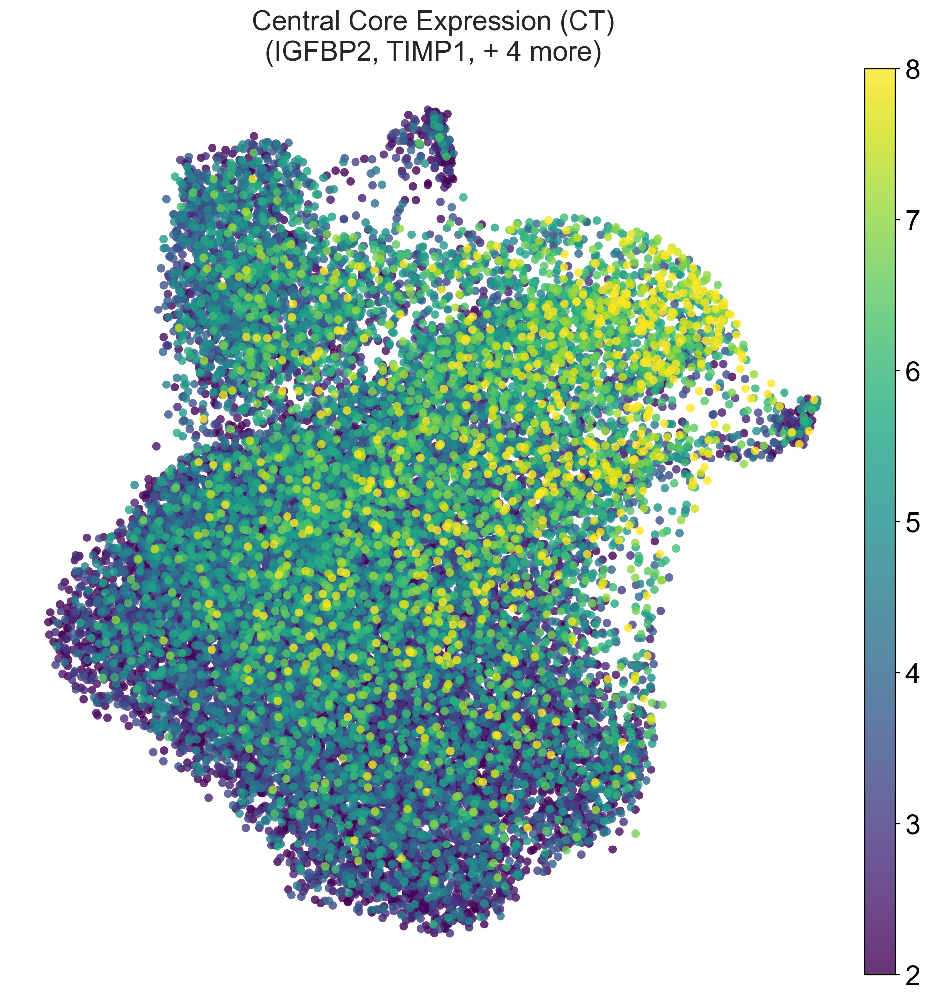

<Figure size 1200x1200 with 0 Axes>

In [309]:
sc.pl.umap(adata, color='ct', frameon=False , vmin=2, vmax=8, size=150, alpha=0.8, title="Central Core Expression (CT)\n(IGFBP2, TIMP1, + 4 more)" , cmap="viridis")
plt.savefig('figures/ct_expression.png', dpi=300, bbox_inches='tight')

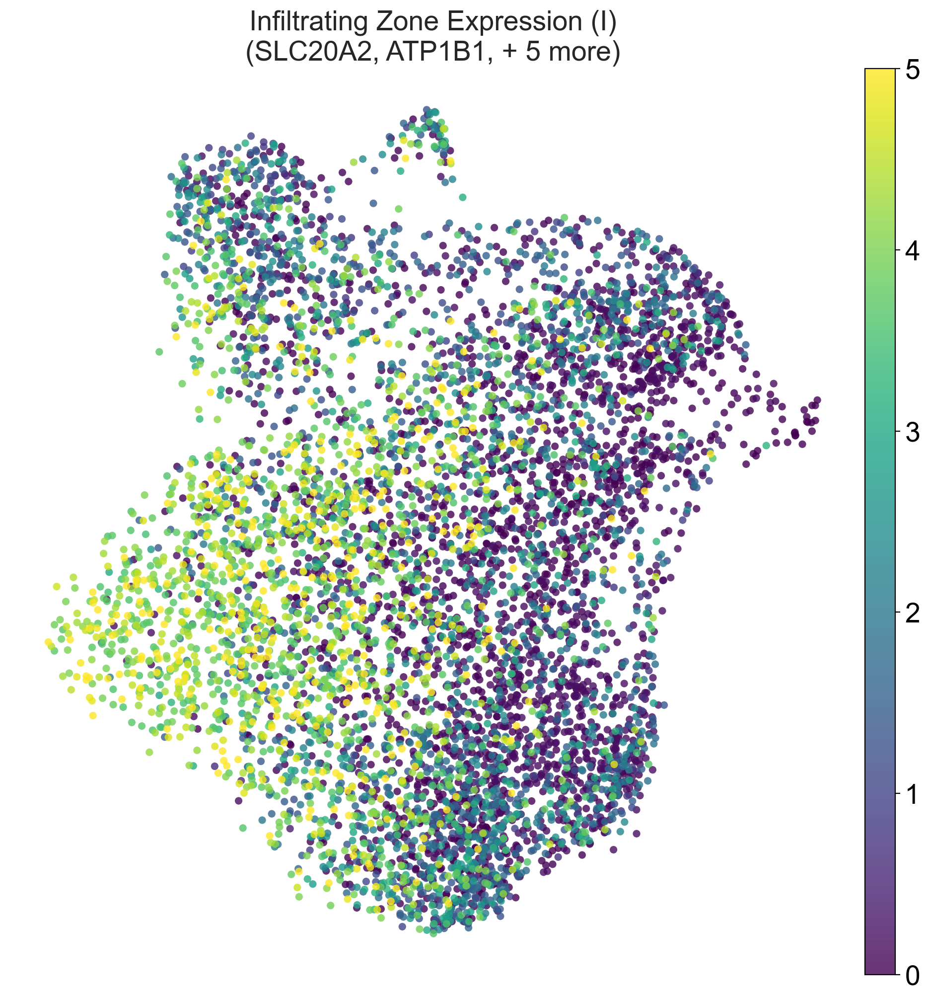

<Figure size 1200x1200 with 0 Axes>

In [386]:
sc.pl.umap(adata, color='infiltrating', frameon=False , size=120, alpha=0.8, vmax=5, vmin=0, title="Infiltrating Zone Expression (I)\n(SLC20A2, ATP1B1, + 5 more)", cmap="viridis")
plt.savefig('figures/infiltrating_expression.png', dpi=300, bbox_inches='tight')

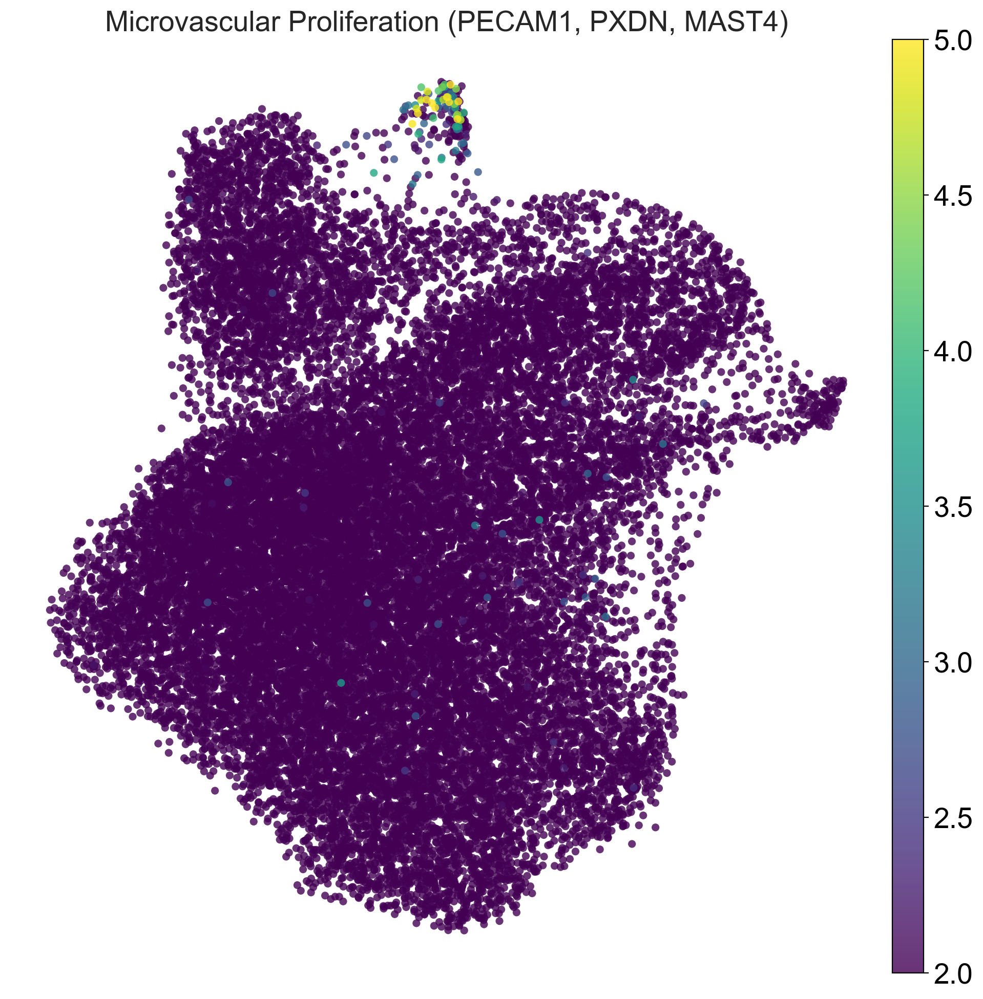

<Figure size 1200x1200 with 0 Axes>

In [362]:
sc.pl.umap(adata, color=['m2'], frameon=False, size=120, alpha=0.8, vmin=2, vmax=5, title="Microvascular Proliferation (PECAM1, PXDN, MAST4)", cmap="viridis")
plt.savefig('figures/microvascular_proliferation.png', dpi=300, bbox_inches='tight')


In [185]:
adata2 = adata.copy()


In [186]:
adata = adata2.copy()

In [363]:
# if perivascular if over 3.5, label class "perivascular"
adata.obs["class"] = 'other'
# adata.obs["class"] = np.where(adata.obs['perinectoric'] > 8, "perinectoric", adata.obs["class"])
adata.obs["class"] = np.where(adata.obs['necrosis'] > 5, "necrosis", adata.obs["class"])
adata.obs["class"] = np.where(adata.obs['infiltrating'] > 3.5, "infiltrating", adata.obs["class"])
adata.obs["class"] = np.where(adata.obs['perivascular'] > 8, "perivascular", adata.obs["class"])
adata.obs["class"] = np.where(adata.obs['ct'] > 5, "ct", adata.obs["class"])
adata.obs["class"] = np.where(adata.obs['leading_edge'] > 2.5, "leading_edge", adata.obs["class"])
adata.obs["class"] = np.where(adata.obs['m2'] > 4.5, "m2", adata.obs["class"])

# drop everything other
adata = adata[adata.obs["class"] != "other", :]

adata.obs["class"] = pd.Categorical(adata.obs["class"], categories=["perinectoric", "necrosis", "infiltrating", "ct", "leading_edge", "m2","perivascular", "other"])


/var/folders/td/y1xv90r510924xxsnlfkjgrc0000gn/T/ipykernel_33455/1438243241.py:14: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["class"] = pd.Categorical(adata.obs["class"], categories=["perinectoric", "necrosis", "infiltrating", "ct", "leading_edge", "m2","perivascular", "other"])


/Users/shaunie/anaconda3/envs/hu-aging/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


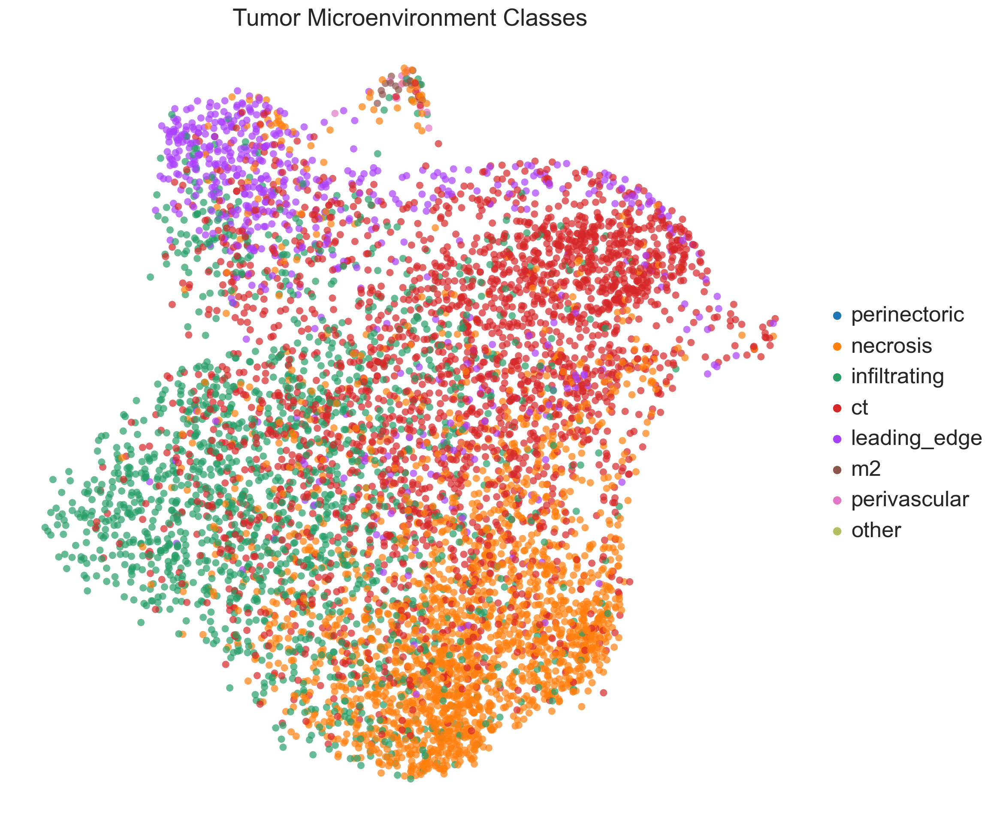

In [364]:
sc.pl.umap(adata, color='class', frameon=False, size=150, alpha=0.7, title="Tumor Microenvironment Classes")
# save figure to file
# plt.savefig('figures/tumor_microenvironment_classes.png', dpi=300, bbox_inches='tight')

# for item in ["perinectoric", "necrosis", "infiltrating", "ct", "leading_edge", "m2","perivascular"]:
#     adata_temp = adata[adata.obs["class"] == item, :]
#     sc.pl.umap(adata_temp, color=item, frameon=False, size=150, alpha=0.7, title=item)
#     # plt.savefig('figures/' + item + '.png', dpi=300, bbox_inches='tight')

In [409]:
lut = dict(zip(adata.obs['class'].unique(), "rbgwcmyp"))
lut

{'necrosis': 'r',
 'ct': 'b',
 'infiltrating': 'g',
 'leading_edge': 'w',
 'perivascular': 'c',
 'm2': 'm'}

In [333]:
# # create a list of gene lists
# gene_lists = [perinectoric_gene_list, necrosis_gene_list, infiltrating_gene_list, perivascular_zone, ct_gene_list, leading_edge, microvascular2]
# names = ["perinectoric", "necrosis", "infiltrating", "perivascular", "ct", "leading_edge", "microvascular2"]
# # big_df = pd.DataFrame()
# # loop over each gene list
# for gene_list in gene_lists:
#     # create a dataframe with the gene expression data for each cluster
#     df = pd.DataFrame()
#     for i in range(adata.obs['louvain'].nunique()):
#         cluster = adata.obs['louvain'].unique()[i]
#         count = adata.obs['count'].unique()[i]     
#         expression = np.log(np.mean(adata[adata.obs['louvain'] == cluster, gene_list].X, axis=0) + 1)
#         # normalize expression
#         df[cluster] = expression
#         df['count'] = cluster
#     df = df.T
#     df.columns = gene_list
#     df = df.reindex(['9', '3','0','1', '2', '7', '8', '5', '6', '4',])
#     df = df.reindex(['9', '3','4','6', '10', '5', '0', '1', '8', '7','2'])


#     df.plot(kind='bar', color=sns.color_palette("viridis"), figsize=(10, 5), width=1)
#     # make width dependent on number of cells in cluster


#     # move legends outside of plot
#     plt.legend(loc='center left', bbox_to_anchor=(1.0, 0.5))
#     # label the genes   
#     # no axis
#     # plt.axis('off')
    

    








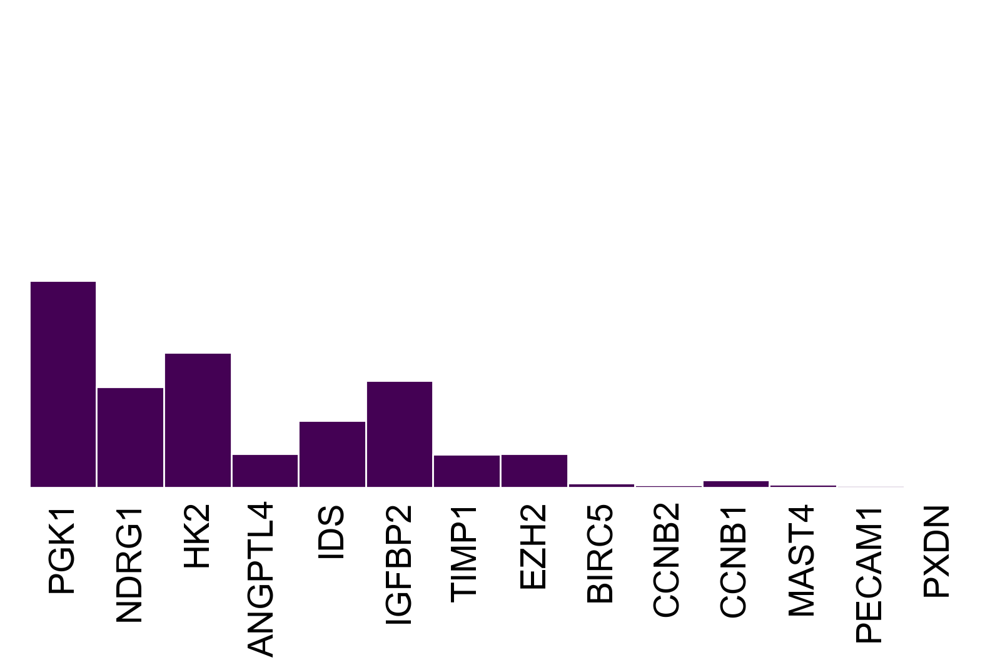

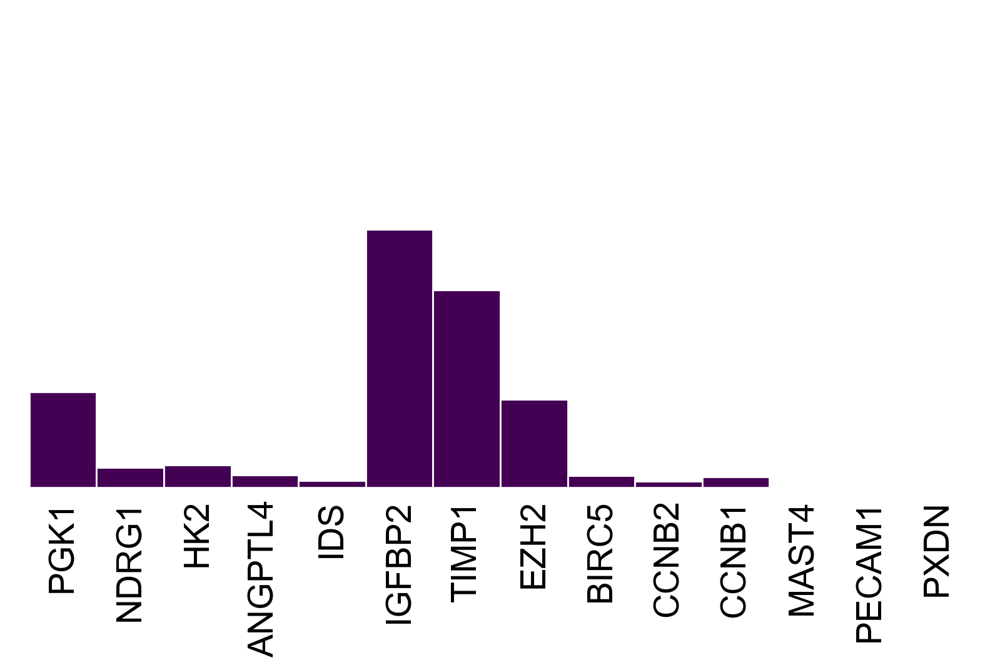

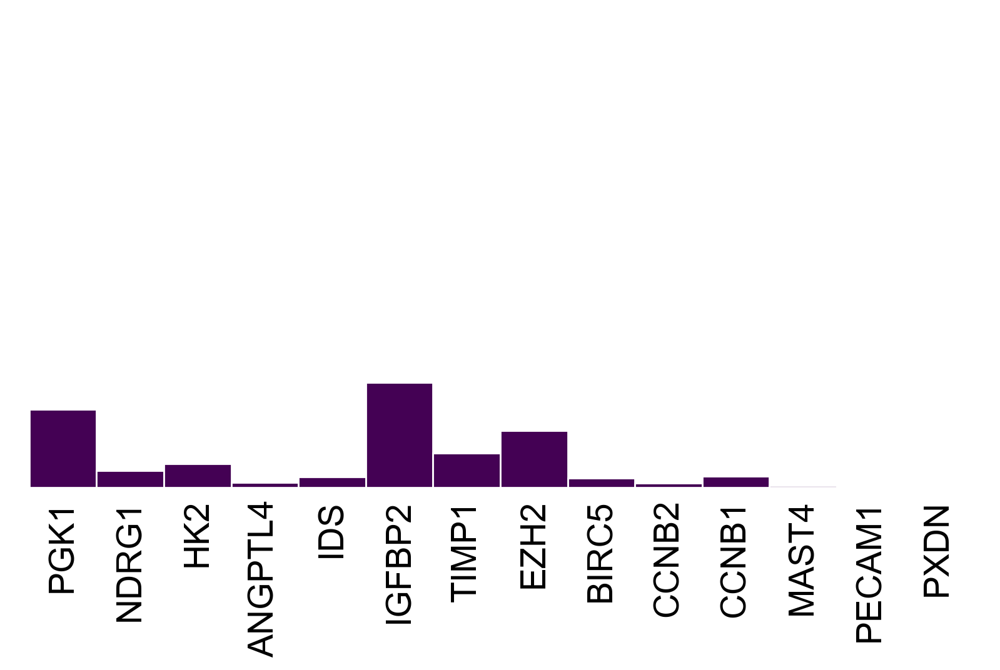

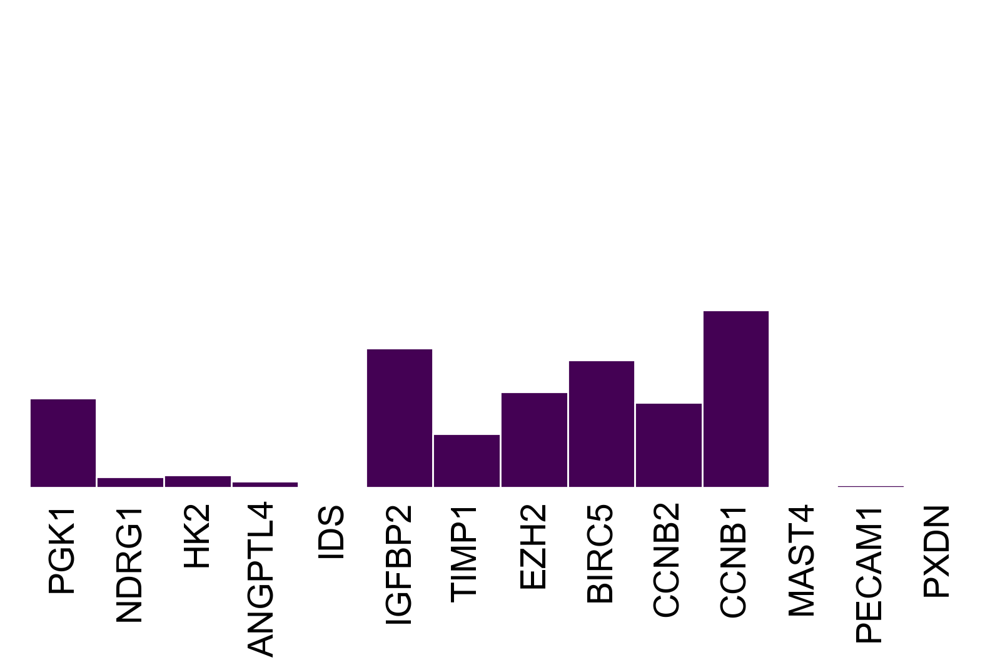

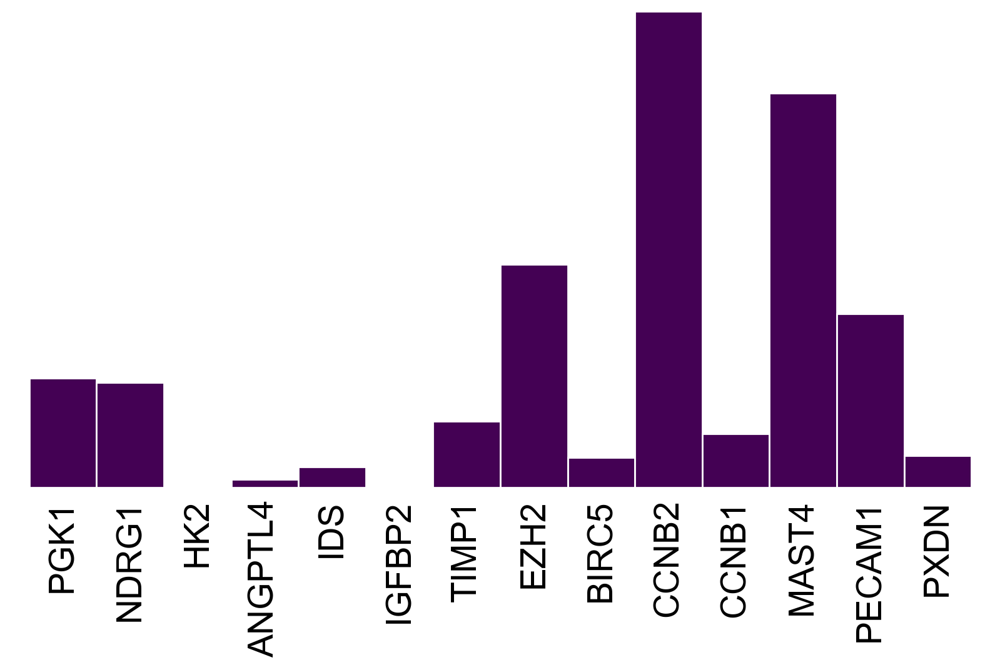

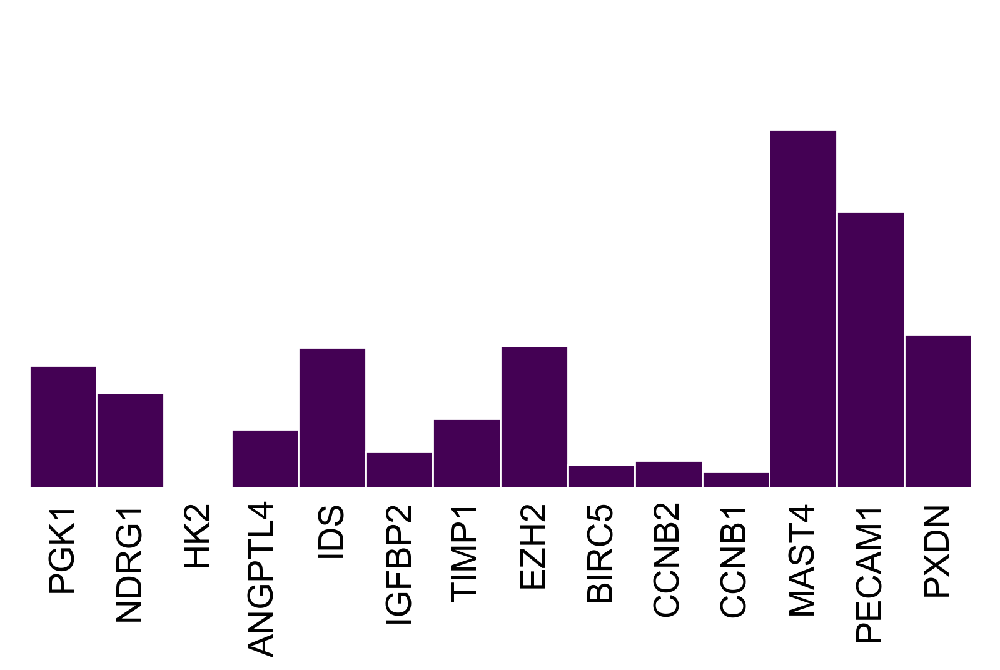

In [440]:
for i in range(adata.obs['class'].nunique()):
        df = pd.DataFrame()
        zone = adata.obs['class'].unique()[i]
        # normalize expression so every gene is from 0 to 1 relative to itself
        normalized_values = (adata[adata.obs['class'] == zone, genes_list].X + np.min(adata[adata.obs['class'] == zone, genes_list].X, axis=0)) / (np.max(adata[adata.obs['class'] == zone, genes_list].X, axis=0)+np.min(adata[adata.obs['class'] == zone, genes_list].X, axis=0))
        # average expression
        expression = np.mean(normalized_values, axis=0)
        # log transform
        df[zone] = expression
        df.index = genes_list
        # reorder to order of genes_list
        df = df.reindex(genes_list)
        # print(df)
        # plot
        df.plot(kind='bar', figsize=(10, 5), width=1, color=['#440154'])


        # remove background grid
        # set y-limit to 2
        plt.ylim(0, 1)
        plt.grid(False)
        # no legend
        plt.legend().remove()
        # remove frame
        plt.box(False)
        # make y ticks 0 to 1
        plt.yticks([])
        # plt.title(zone)



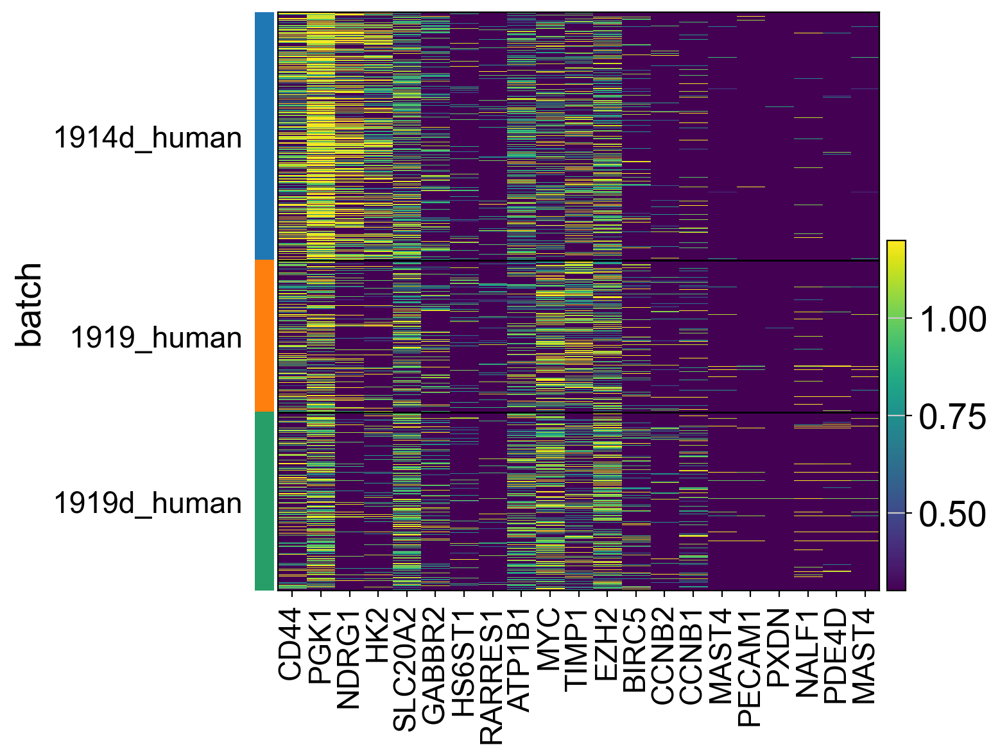

<Figure size 1200x1200 with 0 Axes>

In [120]:

sc.pl.heatmap(adata[adata.obs["class"] != "other", :], var_names=genes_list, groupby='batch', vmin=0.3, vmax=1.2)
# save heatmap to file
plt.savefig('figures/all_niches_heatmap.png', dpi=300, bbox_inches='tight')

